In [1]:
import pandas as pd
from pyarrow import parquet as pq
import ast
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import plotly.express as px
from datasets import Dataset
from tqdm import tqdm
import os

pd.set_option("display.max_colwidth", 100)

### Preprocessing

In [2]:
# METADATa
metadata = Dataset.from_file("/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/data-00000-of-00001.arrow")
output_prefix = "/storage/slurm/schnackl/fakesync/data/mavosdd/dataset"
metadata = metadata.to_pandas()
metadata['video_path'] = metadata['video_path'].apply(lambda x: os.path.join(output_prefix, x))
metadata['target'] = metadata['label'].apply(lambda x: 1 if x == 'fake' else 0)
metadata.head()
# wenn nur indomain runtergeladen dann split=test und open_set_*=False

,video_path,label,split,open_set_model,open_set_language,language,generative_method,target
0,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/inswapper/17624-NkFOqfFDb1c_43_1.mp4,fake,test,False,False,mandarin,inswapper,1
1,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/spanish/real/vVsakoqLuu8_3_2.mp4,real,test,False,False,spanish,real,0
2,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/real/GrQO5stiREI_122_1.mp4,real,test,False,False,mandarin,real,0
3,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/spanish/echomimic/20533_IfZd7tsXHP8_21_1_a...,fake,test,False,False,spanish,echomimic,1
4,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/echomimic/21450_Uk6sPnRL0WQ_116_2...,fake,test,False,False,mandarin,echomimic,1


In [3]:
metadata[['video_path', 'target']].to_csv(output_prefix + '/metadata.csv', index=False)

In [4]:
# EMBEDDINGS
embeddings = pd.read_csv("../outputs/mavos/open_model/forward_embeddings.csv", dtype={"video_name": str})
# embeddings["video_name"] = embeddings["video_name"].str.removeprefix("/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/")
embeddings["audio_emb"] = embeddings["audio_emb"].apply(ast.literal_eval)
embeddings["video_emb"] = embeddings["video_emb"].apply(ast.literal_eval)
# concatenate audio and video embeddings
embeddings["emb"] = embeddings.apply(lambda row: row["audio_emb"] + row["video_emb"], axis=1)

embeddings.head(3)

,video_name,audio_emb,video_emb,emb
0,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/inswapper/17624-NkFOqfFDb1c_43_1.mp4,"[-0.5585136413574219, -0.35588154196739197, -0.2447393536567688, -1.173437237739563, -0.39026829...","[-0.1630740463733673, -0.2239168882369995, -0.00224266666918993, -0.03622472286224365, -0.283797...","[-0.5585136413574219, -0.35588154196739197, -0.2447393536567688, -1.173437237739563, -0.39026829..."
1,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/spanish/real/vVsakoqLuu8_3_2.mp4,"[-1.0882655382156372, 0.1688050478696823, 0.8434819579124451, -1.4033406972885132, -0.4283533394...","[0.15465006232261658, -0.4730275273323059, -0.29855191707611084, -0.9392286539077759, -0.6601951...","[-1.0882655382156372, 0.1688050478696823, 0.8434819579124451, -1.4033406972885132, -0.4283533394..."
2,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/real/GrQO5stiREI_122_1.mp4,"[-0.48167333006858826, -0.39409974217414856, -0.24037879705429077, -0.9880650043487549, -0.51382...","[-1.1298203468322754, 0.5655131340026855, 0.17977046966552734, 0.9099341034889221, 0.38236010074...","[-0.48167333006858826, -0.39409974217414856, -0.24037879705429077, -0.9880650043487549, -0.51382..."


In [9]:
df = pd.merge(embeddings, metadata, left_on="video_name", right_on="video_path", how="inner")
df = df.rename(columns={"generative_method": "method"})
df.head(3)

,video_name,audio_emb,video_emb,emb,video_path,label,split,open_set_model,open_set_language,language,method,target
0,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/inswapper/17624-NkFOqfFDb1c_43_1.mp4,"[-0.5585136413574219, -0.35588154196739197, -0.2447393536567688, -1.173437237739563, -0.39026829...","[-0.1630740463733673, -0.2239168882369995, -0.00224266666918993, -0.03622472286224365, -0.283797...","[-0.5585136413574219, -0.35588154196739197, -0.2447393536567688, -1.173437237739563, -0.39026829...",/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/inswapper/17624-NkFOqfFDb1c_43_1.mp4,fake,test,False,False,mandarin,inswapper,1
1,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/spanish/real/vVsakoqLuu8_3_2.mp4,"[-1.0882655382156372, 0.1688050478696823, 0.8434819579124451, -1.4033406972885132, -0.4283533394...","[0.15465006232261658, -0.4730275273323059, -0.29855191707611084, -0.9392286539077759, -0.6601951...","[-1.0882655382156372, 0.1688050478696823, 0.8434819579124451, -1.4033406972885132, -0.4283533394...",/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/spanish/real/vVsakoqLuu8_3_2.mp4,real,test,False,False,spanish,real,0
2,/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/real/GrQO5stiREI_122_1.mp4,"[-0.48167333006858826, -0.39409974217414856, -0.24037879705429077, -0.9880650043487549, -0.51382...","[-1.1298203468322754, 0.5655131340026855, 0.17977046966552734, 0.9099341034889221, 0.38236010074...","[-0.48167333006858826, -0.39409974217414856, -0.24037879705429077, -0.9880650043487549, -0.51382...",/storage/slurm/schnackl/fakesync/data/mavosdd/dataset/mandarin/real/GrQO5stiREI_122_1.mp4,real,test,False,False,mandarin,real,0


In [19]:
# subsample df
df[df["open_set_model"] == False]["label"].value_counts(), df.label.value_counts()
df_sample = df.sample(n=min(1000, df.shape[0]), random_state=42).reset_index(drop=True)

df_hard = df[df["method"].isin(["real", "inswapper", "hififace", "roop"])].reset_index(drop=True)
# df = df_hard

In [ ]:
print("Embedding size")
len(df.video_emb[0])

Embedding size


768

### Visualizations

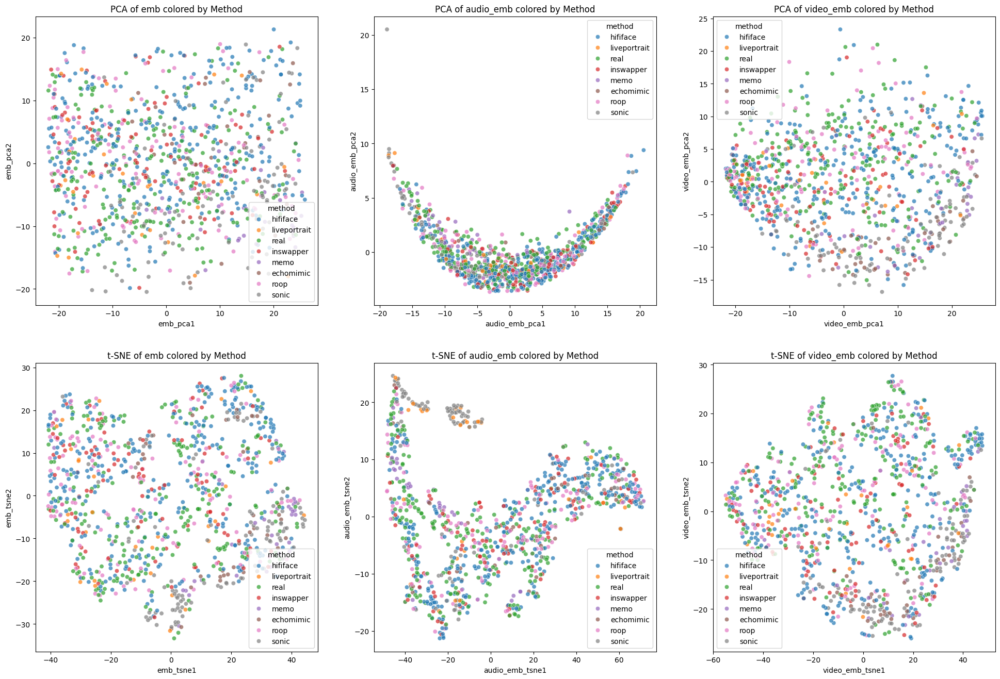

In [13]:
pca = PCA(n_components=2, random_state=42)
tsne = TSNE(n_components=2, random_state=42)

fig, ax = plt.subplots(2, 3, figsize=(24, 16))

for i, embed in enumerate(["emb", "audio_emb", "video_emb"]):
    X = np.array(list(df_sample[embed]))
    # subsample X
    # x = np.random.choice(X.shape[0], size=min(1000, X.shape[0]), replace=False)
    pca_comp = pca.fit_transform(X)
    tsne_comp = tsne.fit_transform(X)
    df_sample[f"{embed}_pca1"] = pca_comp[:, 0]
    df_sample[f"{embed}_pca2"] = pca_comp[:, 1]
    df_sample[f"{embed}_tsne1"] = tsne_comp[:, 0]
    df_sample[f"{embed}_tsne2"] = tsne_comp[:, 1]

    sns.scatterplot(data=df_sample, x=f"{embed}_pca1", y=f"{embed}_pca2", hue="method", ax=ax[0][i], alpha=0.7)
    sns.scatterplot(data=df_sample, x=f"{embed}_tsne1", y=f"{embed}_tsne2", hue="method", ax=ax[1][i], alpha=0.7)
    ax[0][i].set_title(f"PCA of {embed} colored by Method")
    ax[1][i].set_title(f"t-SNE of {embed} colored by Method")

plt.show()

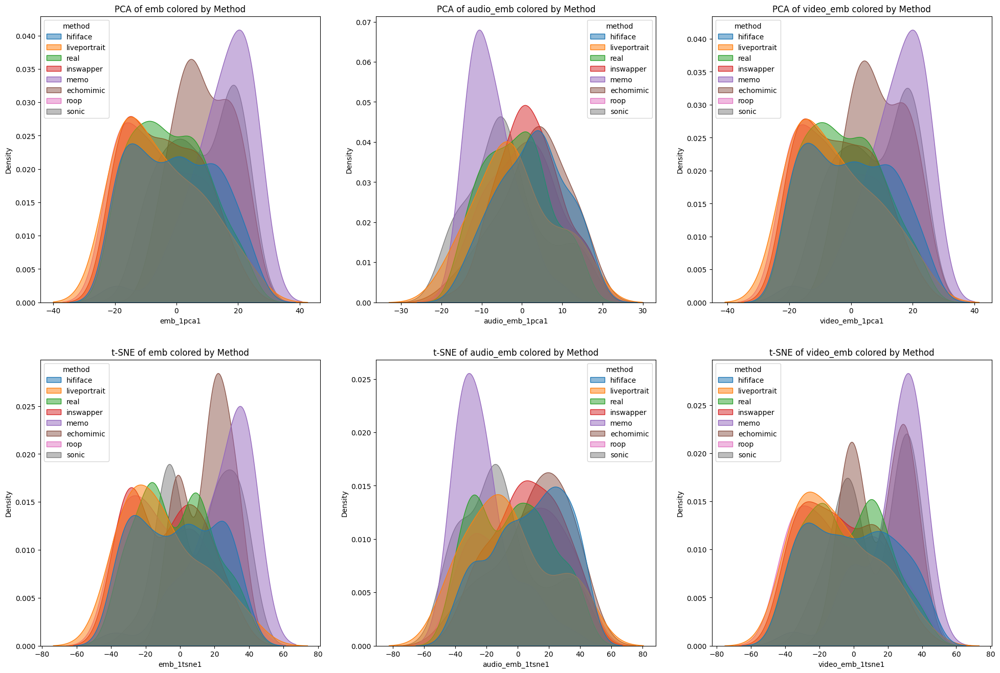

In [14]:
pca = PCA(n_components=1, random_state=42)
tsne = TSNE(n_components=1, random_state=42, perplexity=30, max_iter=500)

fig, ax = plt.subplots(2, 3, figsize=(24, 16))

for i, embed in enumerate(["emb", "audio_emb", "video_emb"]):
    X = np.array(list(df_sample[embed]))
    pca_comp = pca.fit_transform(X)
    tsne_comp = tsne.fit_transform(X)
    df_sample[f"{embed}_1pca1"] = pca_comp[:, 0]
    df_sample[f"{embed}_1tsne1"] = tsne_comp[:, 0]

    sns.kdeplot(data=df_sample, x=f"{embed}_1pca1", hue="method", fill=True, common_norm=False, alpha=0.5, ax=ax[0][i])
    sns.kdeplot(data=df_sample, x=f"{embed}_1tsne1", hue="method", fill=True, common_norm=False, alpha=0.5, ax=ax[1][i])
    ax[0][i].set_title(f"PCA of {embed} colored by Method")
    ax[1][i].set_title(f"t-SNE of {embed} colored by Method")

plt.show()

### PCA fit on real only

In [15]:
# fit pca only on real ones
df.head()
# fit
pca = PCA(n_components=2)
reals = list(df[df["method"] == "real"]["emb"])
pca.fit(reals)
# transform
df["pca1_real"] = pca.transform(df["emb"].to_list())[:, 0]
df["pca2_real"] = pca.transform(df["emb"].to_list())[:, 1]

In [16]:
fig = px.scatter(df, x="pca1_real", y="pca2_real", color="method", hover_data=["video_name"], opacity=0.8, width=800, height=600)
fig.update_layout(title="PCA of Audio concat Video Embeddings colored by Method")
fig.show()

# LDA

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

lda = LinearDiscriminantAnalysis(n_components=1)
lda.fit_transform(df["emb"].to_list(), df["label"].to_list())
df["lda_label"] = lda.transform(df["emb"].to_list())[:, 0]

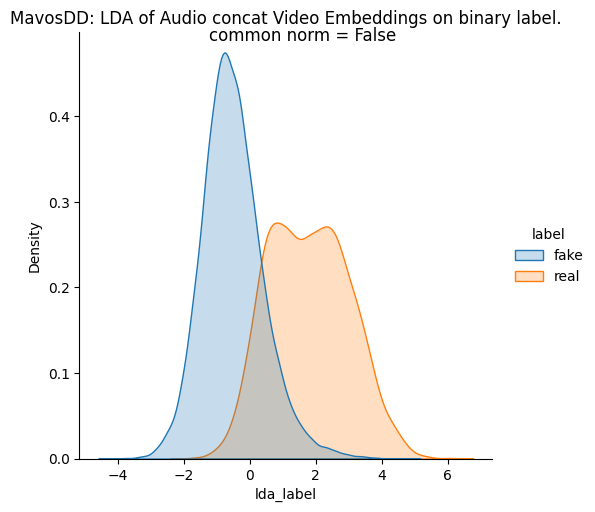

In [46]:

fig = sns.displot(df, x="lda_label", hue="label", kind="kde", fill=True, common_norm=False)
plt.title("MavosDD: LDA of Audio concat Video Embeddings on binary label.")
plt.suptitle("common norm = False")
plt.show()

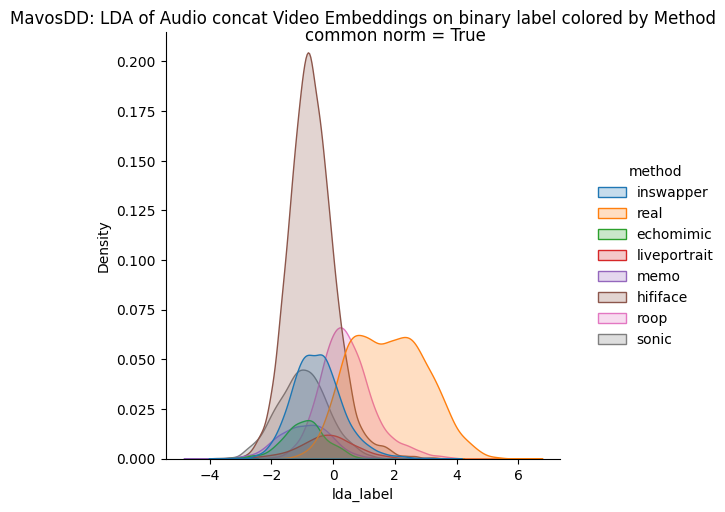

In [47]:
fig = sns.displot(df, x="lda_label", hue="method", kind="kde", fill=True, common_norm=True)
plt.title("MavosDD: LDA of Audio concat Video Embeddings on binary label colored by Method")
plt.suptitle("common norm = True")
plt.show()

In [31]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

lda = LinearDiscriminantAnalysis(n_components=2)
lda.fit_transform(df["emb"].to_list(), df["method"].to_list())
df["lda1"] = lda.transform(df["emb"].to_list())[:, 0]
df["lda2"] = lda.transform(df["emb"].to_list())[:, 1]

In [32]:
fig = px.scatter(df, x="lda1", y="lda2", color="method", hover_data=["video_name"], opacity=0.8, width=1000, height=800)
fig.update_layout(title="MavosDD: LDA of Audio concat Video Embeddings on multiclass method colored by Method")
fig.show()

In [33]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

lda = LinearDiscriminantAnalysis(n_components=1)
lda.fit_transform(df["emb"].to_list(), df["method"].to_list())
df["lda1_of_1"] = lda.transform(df["emb"].to_list())[:, 0]

In [34]:
fig = px.scatter(df, x="lda_label", y="lda1_of_1", color="method", hover_data=["video_name"], opacity=0.8, width=1000, height=800)
fig.update_layout(title="MavosDD: LDA of Audio concat Video Embeddings on multiclass method colored by Method")
fig.show()

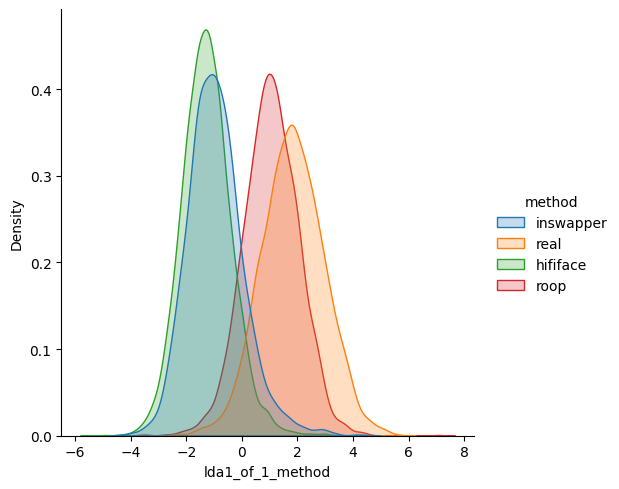

In [ ]:
# hard df but one component lda on label
lda = LinearDiscriminantAnalysis(n_components=1)    
lda.fit_transform(df_hard["emb"].to_list(), df_hard["label"].to_list())
df_hard["lda1_of_1_label"] = lda.transform(df_hard["emb"].to_list())[:, 0]
# lda nach method
lda.fit_transform(df_hard["emb"].to_list(), df_hard["method"].to_list())
df_hard["lda1_of_1_method"] = lda.transform(df_hard["emb"].to_list())[:, 0]



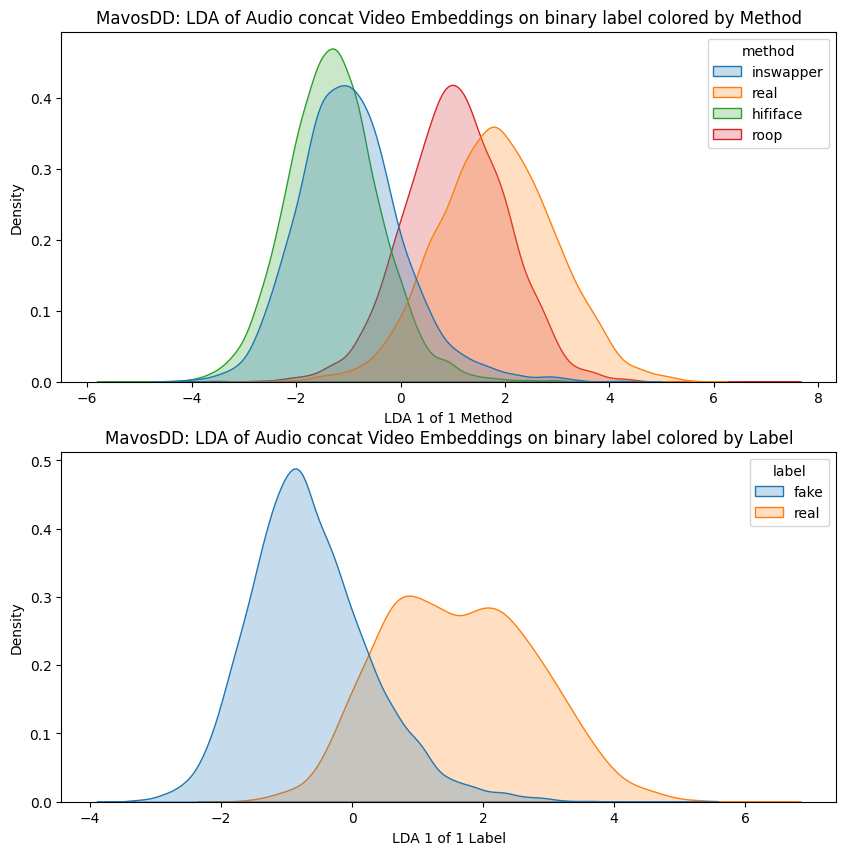

In [55]:

fig, ax = plt.subplots(2, 1, figsize=(10, 10))
sns.kdeplot(df_hard, x="lda1_of_1_method", hue="method", fill=True, common_norm=False, ax=ax[0])
ax[0].set_title("MavosDD: LDA of Audio concat Video Embeddings on binary label colored by Method")
ax[0].set_xlabel("LDA 1 of 1 Method")
sns.kdeplot(df_hard, x="lda1_of_1_label", hue="label", fill=True, common_norm=False, ax=ax[1])
ax[1].set_title("MavosDD: LDA of Audio concat Video Embeddings on binary label colored by Label")
ax[1].set_xlabel("LDA 1 of 1 Label")
plt.show()

In [35]:
# HARD DF
# filter df for only real, inswapper, hififace and roop
# do LDA again
lda = LinearDiscriminantAnalysis(n_components=2)
lda.fit_transform(df_hard["emb"].to_list(), df_hard["method"].to_list())
df_hard["lda1"] = lda.transform(df_hard["emb"].to_list())[:, 0]
df_hard["lda2"] = lda.transform(df_hard["emb"].to_list())[:, 1]
fig = px.scatter(df_hard, x="lda1", y="lda2", color="method", hover_data=["video_name"], opacity=0.8, width=1000, height=800)
fig.update_layout(title="MavosDD: LDA of Audio concat Video Embeddings (filtered) colored by Method")
fig.show()


In [38]:
# lda nach label
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
lda = LinearDiscriminantAnalysis(n_components=1)
lda.fit_transform(df_hard["emb"].to_list(), df_hard["label"].to_list())
df_hard["lda1_of_1_label"] = lda.transform(df_hard["emb"].to_list())[:, 0]
# lda nach method
lda.fit_transform(df_hard["emb"].to_list(), df_hard["method"].to_list())
df_hard["lda1_of_1_method"] = lda.transform(df_hard["emb"].to_list())[:, 0]

In [39]:
fig = px.scatter(df_hard, x="lda1_of_1_label", y="lda1_of_1_method", color="method", hover_data=["video_name"], opacity=0.8, width=1000, height=800)
fig.update_layout(title="MavosDD: LDA of Audio concat Video Embeddings colored by Method and label")
fig.show()

In [40]:
fig = px.scatter(df, x="lda1", y="lda2", color="label", hover_data=["video_name"], opacity=0.8, width=1000, height=800)
fig.update_layout(title="LDA of Audio concat Video Embeddings colored by Method")
fig.show()

In [58]:
# also do for language

lda = LinearDiscriminantAnalysis(n_components=2)
lda.fit_transform(df["audio_emb"].to_list(), df["language"].to_list())
df["lda_lan1"] = lda.transform(df["audio_emb"].to_list())[:, 0]
df["lda_lan2"] = lda.transform(df["audio_emb"].to_list())[:, 1]
fig = px.scatter(df, x="lda_lan1", y="lda_lan2", color="language", hover_data=["video_name"], opacity=0.8, width=1000, height=800)
fig.update_layout(title="LDA of Audio concat Video Embeddings colored by Language")
fig.show()

### Anomaly Detection

In [30]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import IsolationForest
import numpy as np
from sklearn.svm import OneClassSVM
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.metrics import roc_auc_score, average_precision_score
from sklearn.model_selection import train_test_split

df["emb"] = df["emb"].apply(lambda x: np.array(x, dtype=np.float32))
X = np.stack(df["emb"].values)
labels = df["method"].values

# X: (N, 1536) embeddings; y_test: 0=real, 1=fake for evaluation only
X_real = df[df["method"] == "real"]["emb"].to_list()
X_fake = df[df["method"] != "real"]["emb"].to_list()
# sample one half of real samples in train
X_train, X_test, y_train, y_test = train_test_split(X_real, [0]*len(X_real), test_size=0.5, random_state=42)
X_test += X_fake
y_test += [1]*len(X_fake)
y_test = np.array(y_test)

ROC-AUC: 0.5733473343365708
PR-AUC: 0.8775789048195898


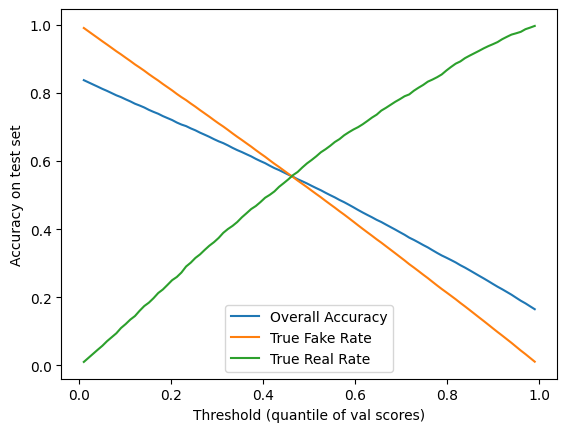

In [31]:
# pipeline: scale -> (optional) PCA -> one-class SVM
scaler = StandardScaler().fit(X_train)
Xr = scaler.transform(X_train)
Xt = scaler.transform(X_test)

pca = PCA(n_components=0.95, svd_solver='full').fit(Xr)   # keep 95% variance (speed up)
Xr_p = pca.transform(Xr)
Xt_p = pca.transform(Xt)

ocsvm = OneClassSVM(kernel='rbf', gamma='scale', nu=0.7) # nu ≈ expected outlier rate in real-set
ocsvm.fit(Xr_p)

# decision_function: larger = more normal (inlier)
scores = -ocsvm.decision_function(Xt_p).ravel()

print("ROC-AUC:", roc_auc_score(y_test, scores))
print("PR-AUC:", average_precision_score(y_test, scores))

# choose threshold for a target FPR (e.g., 5%) using real-only validation:
# val_scores = -ocsvm.decision_function(Xr).ravel()

thr_list = np.linspace(0.01, 0.99, num=98)
qtl_list = np.quantile(scores, thr_list)  # 5% of real flagged as fake

result = {
    "accuracy": [],
    "true_fake_ratio": [],
    "true_real_ratio": []
}
for i, thr in enumerate(qtl_list):
    y_hat = (scores >= thr).astype(int)
    acc = (np.array(y_test) == y_hat).mean()
    true_fake_ratio = ((y_hat == 1) & (y_test == 1)).sum() / (y_test == 1).sum()
    true_real_ratio = ((y_hat == 0) & (y_test == 0)).sum() / (y_test == 0).sum()
    result["accuracy"].append(acc)
    result["true_fake_ratio"].append(true_fake_ratio)
    result["true_real_ratio"].append(true_real_ratio)
    

# plot acclist
plt.plot(thr_list, result["accuracy"])
plt.plot(thr_list, result["true_fake_ratio"])
plt.plot(thr_list, result["true_real_ratio"])
plt.xlabel("Threshold (quantile of val scores)")
plt.ylabel("Accuracy on test set")
plt.legend(["Overall Accuracy", "True Fake Rate", "True Real Rate"])

In [11]:
from sklearn.ensemble import IsolationForest

iso = IsolationForest(n_estimators=300, max_samples='auto', random_state=42)
iso.fit(Xr)  # train on real only

# higher = more abnormal if we flip sign of score_samples
scores_fake = -iso.score_samples(Xt)
print("ROC-AUC:", roc_auc_score(y_test, scores_fake))
print("AP:", average_precision_score(y_test, scores_fake))


ROC-AUC: 0.6145446308796301
AP: 0.912516240834397


In [27]:
from sklearn.metrics import roc_auc_score

pca = PCA(n_components=0.95, svd_solver='full').fit(Xr)
Xr_rec = pca.inverse_transform(pca.transform(Xr))
Xt_rec = pca.inverse_transform(pca.transform(Xt))

def mse(a,b): return ((a-b)**2).mean(axis=1)
scores_fake = mse(Xt, Xt_rec)  # higher error => more fake
print("ROC-AUC:", roc_auc_score(y_test, scores_fake))
print("AP:", average_precision_score(y_test, scores_fake))


ROC-AUC: 0.5734540355766933
AP: 0.9068768824545825


In [28]:
from sklearn.covariance import LedoitWolf
mu = Xr.mean(axis=0, keepdims=True)
lw = LedoitWolf().fit(Xr - mu)
# Squared Mahalanobis distance
diff = Xt - mu
scores_fake = np.einsum('ij,jk,ik->i', diff, lw.precision_, diff)
print("ROC-AUC:", roc_auc_score(y_test, scores_fake))
print("AP:", average_precision_score(y_test, scores_fake))

ROC-AUC: 0.6629356013870346
AP: 0.9323199910577044


In [29]:
len(df.audio_emb.iloc[0]), len(df.video_emb.iloc[0])

(768, 768)

In [30]:
# kmeans
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=2, random_state=42)
kmeans.fit(X)
df['kmeans_label'] = kmeans.labels_

In [31]:
# visualize kmeans results
fig = px.scatter(df, x="lda1", y="lda2", color="kmeans_label", hover_data=["video_name"], opacity=0.8, width=800, height=600)
fig.update_layout(title="PCA of Audio concat Video Embeddings colored by KMeans label")
fig.show()

In [32]:
# dbscan
from sklearn.cluster import HDBSCAN
dbscan = HDBSCAN()
dbscan.fit(X)
df['dbscan_label'] = dbscan.labels_

In [33]:
# visualize kmeans results
fig = px.scatter(df, x="lda_lan1", y="lda_lan2", color="dbscan_label", hover_data=["video_name"], opacity=0.8, width=800, height=600)
fig.update_layout(title="PCA of Audio concat Video Embeddings colored by DBSCAN label")
fig.show()

ValueError: Value of 'x' is not the name of a column in 'data_frame'. Expected one of ['video_name', 'audio_emb', 'video_emb', 'emb', 'video_path', 'label', 'split', 'open_set_model', 'open_set_language', 'language', 'method', 'target', 'pca1_real', 'pca2_real', 'lda_label', 'lda1', 'lda2', 'kmeans_label', 'dbscan_label'] but received: lda_lan1

In [ ]:
# train simple AE from video to audio on real only

import torch
from torch import nn, optim
from torch.utils.data import DataLoader, TensorDataset

ae = nn.Sequential(
    nn.Linear(len(df.video_emb.iloc[0]), 512),
    nn.ReLU(),
    nn.Linear(512, 256),
    nn.ReLU(),
    nn.Linear(256, 128),
    nn.ReLU(),
    nn.Linear(128, 256),
    nn.ReLU(),
    nn.Linear(256, 512),
    nn.ReLU(),
    nn.Linear(512, len(df.audio_emb.iloc[0])),
)

X_video = np.stack(df[df["method"] == "real"]["video_emb"].values)
X_audio = np.stack(df[df["method"] == "real"]["audio_emb"].values)
dataset = TensorDataset(torch.tensor(X_video, dtype=torch.float32), torch.tensor(X_audio, dtype=torch.float32))
dataloader = DataLoader(dataset, batch_size=32, shuffle=True)

criterion = nn.MSELoss()
optimizer = optim.Adam(ae.parameters(), lr=1e-3)

num_epochs = 50
for epoch in range(num_epochs):
    ae.train()
    running_loss = 0.0
    for inputs, targets in dataloader:
        optimizer.zero_grad()
        outputs = ae(inputs)
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()
        running_loss += loss.item() * inputs.size(0)
    epoch_loss = running_loss / len(dataloader.dataset)
    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {epoch_loss:.4f}")


Epoch 1/50, Loss: 0.1347
Epoch 2/50, Loss: 0.1064
Epoch 3/50, Loss: 0.1018
Epoch 4/50, Loss: 0.1008
Epoch 5/50, Loss: 0.0978
Epoch 6/50, Loss: 0.0966


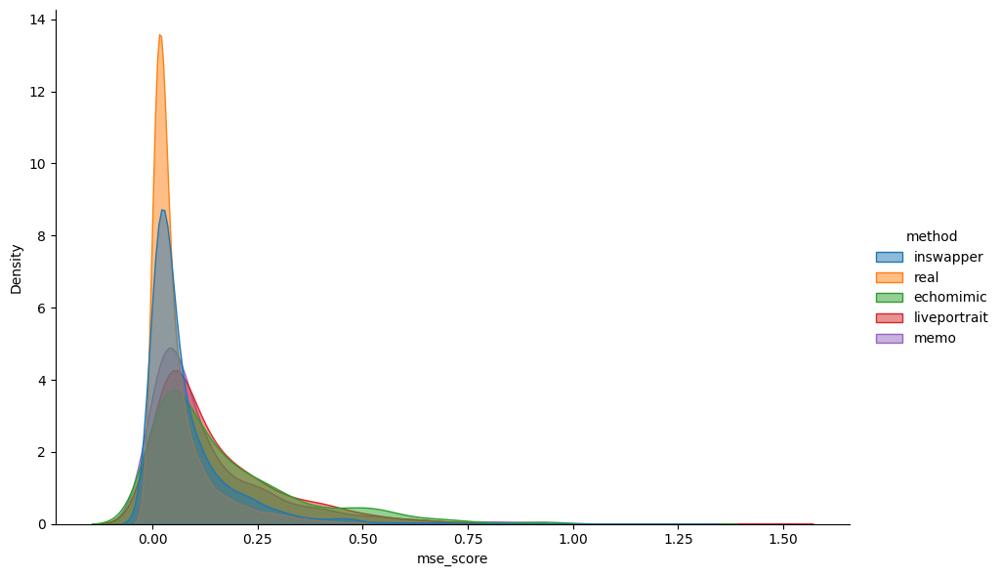

In [ ]:
# evaluate on test set
X_video_test = np.stack(df["video_emb"].values)
X_audio_test = np.stack(df["audio_emb"].values)
with torch.no_grad():
    ae.eval()
    X_audio_pred = ae(torch.tensor(X_video_test, dtype=torch.float32)).numpy()
    
mse_scores = ((X_audio_test - X_audio_pred) ** 2).mean(axis=1)
cosine_similarity = ((X_audio_test * X_audio_pred).sum(axis=1)) / (np.linalg.norm(X_audio_test, axis=1) * np.linalg.norm(X_audio_pred, axis=1))
df['vae_mse_score'] = mse_scores
df['vae_cosine_similarity'] = cosine_similarity

sns.displot(df, x="mse_score", hue="method", kind="kde", fill=True, common_norm=False, alpha=0.5, height=6, aspect=1.5)
plt.title("MavosDD: VAE MSE of Audio Prediction from Video Embeddings colored by Method")
plt.show()
sns.displot(df, x="vae_cosine_similarity", hue="method", kind="kde", fill=True, common_norm=False, alpha=0.5, height=6, aspect=1.5)
plt.title("MavosDD: VAE Cosine Similarity of Audio Prediction from Video Embeddings colored by Method")
plt.show()

In [ ]:
from vae import run_cross_modal

run_cross_modal(df, "video_emb", "audio_emb", "target", max_epochs=100, val_frac=0.2, test_frac=0.2, lr=1e-3, hidden=(512, 256), batch_size=1024)

Seed set to 42
/storage/slurm/schnackl/fakesync/myVenv/.venv/lib/python3.12/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /storage/slurm/schnackl/fakesync/myVenv/.venv/lib/py ...
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name | Type             | Params | Mode 
--------------------------------------------------
0 | f_va | MLP              | 722 K  | train
1 | f_av | MLP              | 722 K  | train
2 | mse  | MSELoss          | 0      | train
3 | cos  | CosineSimilarity | 0      | train
--------------------------------------------------
1.4 M     Trainable params
0         Non-trainable params
1.4 M     Total params
5.779     Total estimated model params size (MB)
20    

Sanity Checking: |          | 0/? [00:00<?, ?it/s]

/storage/slurm/schnackl/fakesync/myVenv/.venv/lib/python3.12/site-packages/lightning/pytorch/loops/fit_loop.py:310: The number of training batches (4) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.


Training: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

Validation: |          | 0/? [00:00<?, ?it/s]

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting: |          | 0/? [00:00<?, ?it/s]


=== Cross-Modal Anomaly Detection (held-out reals + all fakes) ===
ROC-AUC (score): 0.652910
AP (score): 0.883463
ROC-AUC (mse_va): 0.599587
AP (mse_va): 0.862823
ROC-AUC (mse_av): 0.654315
AP (mse_av): 0.881114
n_test: 5738
n_fakes: 4701
n_reals: 1037


{'model': CrossModalTranslator(
   (f_va): MLP(
     (net): Sequential(
       (0): Linear(in_features=768, out_features=512, bias=True)
       (1): ReLU()
       (2): Dropout(p=0.0, inplace=False)
       (3): Linear(in_features=512, out_features=256, bias=True)
       (4): ReLU()
       (5): Dropout(p=0.0, inplace=False)
       (6): Linear(in_features=256, out_features=768, bias=True)
     )
   )
   (f_av): MLP(
     (net): Sequential(
       (0): Linear(in_features=768, out_features=512, bias=True)
       (1): ReLU()
       (2): Dropout(p=0.0, inplace=False)
       (3): Linear(in_features=512, out_features=256, bias=True)
       (4): ReLU()
       (5): Dropout(p=0.0, inplace=False)
       (6): Linear(in_features=256, out_features=768, bias=True)
     )
   )
   (mse): MSELoss()
   (cos): CosineSimilarity()
 ),
 'V_mu': tensor([[-1.3945e+00,  1.3261e-01, -3.2700e-01,  5.9497e-02, -9.2833e-01,
           9.8818e-02,  4.7567e-01,  6.4469e-01,  1.1944e+00, -4.8886e-01,
          -2.2136e-

# Cosine similaity a vs v


In [8]:
a = df["audio_emb"].iloc[0]
b = df["video_emb"].iloc[0]
from sklearn.metrics.pairwise import cosine_similarity
cosine_similarity([a], [b])

array([[0.09379348]])

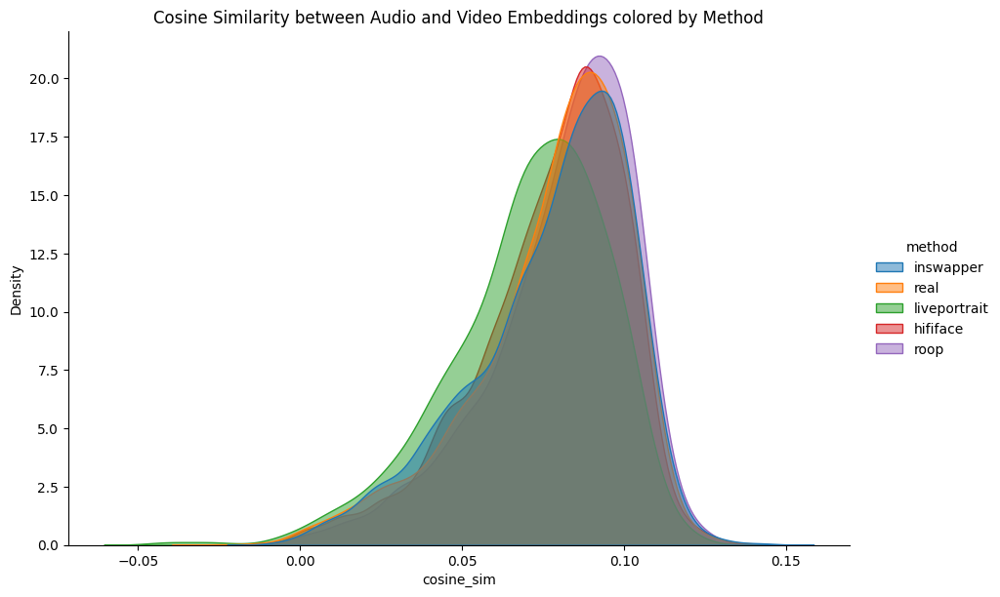

In [38]:
# create column with cosine similarity between audio and video embeddings
from sklearn.metrics.pairwise import cosine_similarity
df['cosine_sim'] = df.apply(lambda row: cosine_similarity([row['audio_emb']], [row['video_emb']])[0][0], axis=1)
sns.displot(df, x="cosine_sim", hue="method", kind="kde", fill=True, common_norm=False, alpha=0.5, height=6, aspect=1.5)
plt.title("Cosine Similarity between Audio and Video Embeddings colored by Method")
plt.show()

# Idea: cross validate semi supervised anomaly detection methods

In [ ]:
# train classifier on closed set and eval on opoen set model

